In [152]:
import matplotlib.pyplot as plt

def show_img(img):
    plt.imshow(img)
    plt.axis('off')
    plt.show()

In [163]:
import numpy as np
import imageio
from IPython.display import HTML, clear_output
import base64

from typing import List


def save_video(frames: List[np.ndarray], filename: str = 'video', format='mp4', fps: int = 1) -> str:
    """
    Saves a video of the policy being evaluating in an environment.

    Args:
        frames (List[np.ndarray]): The frames of the video.
        filename (str): The name of the file to save the video to.
        fps (int): The frames per second of the video.

    Returns:
        str: The path to the saved video.
    """
    if not filename.endswith(f'.{format}'):
        filename = filename + f'.{format}'

    imageio.mimwrite(filename, frames, fps=fps)

    return filename


def embed_mp4(filename: str, clear_before=True, width=640, height=480) -> HTML:
    """Embeds an mp4 file in the notebook."""
    video = open(filename, 'rb').read()
    b64 = base64.b64encode(video)
    tag = '''
    <video width="{0}" height="{1}" controls>
    <source src="data:video/mp4;base64,{2}" type="video/mp4">
    Your browser does not support the video tag.
    </video>'''.format(width, height, b64.decode())

    if clear_before:
        clear_output()

    return HTML(tag)

In [125]:
import torch
from diffusers import StableDiffusionPipeline, DPMSolverMultistepScheduler

model_id = "stabilityai/stable-diffusion-2-1"

# Use the DPMSolverMultistepScheduler (DPM-Solver++) scheduler here instead
pipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config)
pipe = pipe.to("cuda")

Fetching 22 files:   0%|          | 0/22 [00:00<?, ?it/s]

In [2]:
# prompt = "a photo of an astronaut riding a horse on mars"
# image = pipe(prompt).images[0]
# image.save("astronaut_rides_horse.png")

In [3]:
# class LatentsCache:

#     def __init__(self, create_imgs = False):
#         self.latents = []
#         self.create_imgs = create_imgs
#         self.imgs = []

#     def __call__(self, i, t, latents, **kwargs):
#         self.latents.append(latents)
#         if self.create_imgs:
#             self.imgs.append(pipe.decode_latents(latents))
class LatentsCache:

    def __init__(self):
        self.latents = None

    def __call__(self, i, t, latents, **kwargs):
        self.latents = latents

  0%|          | 0/1 [00:00<?, ?it/s]

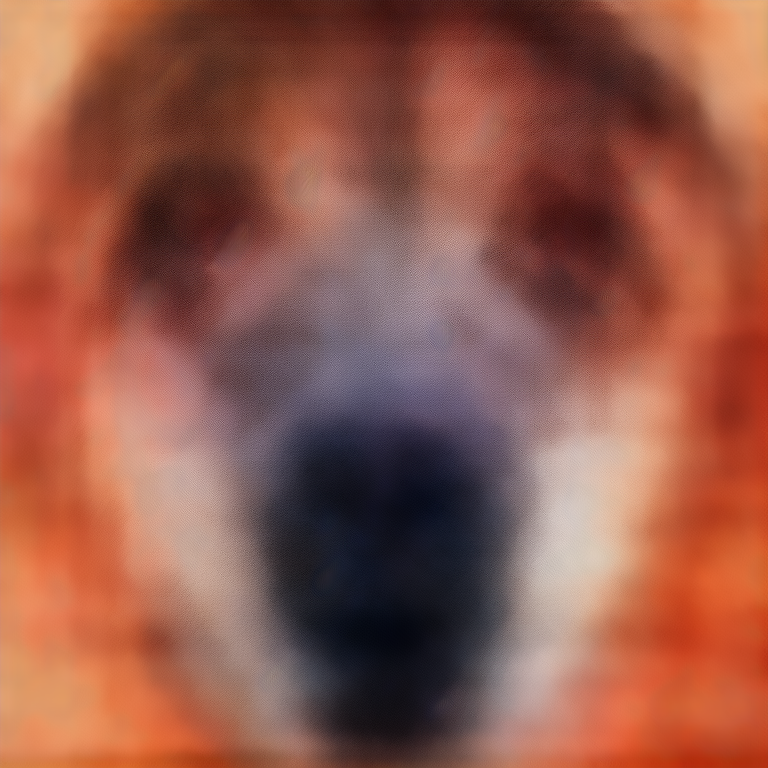

In [4]:
# Create latents for the prompt
prompt = "a face of a dog"
# latents, _ = pipe.create_latents(prompt)
latents_cache = LatentsCache()
image = pipe(prompt, callback=latents_cache, num_inference_steps=1).images[0]
image

  0%|          | 0/1 [00:00<?, ?it/s]

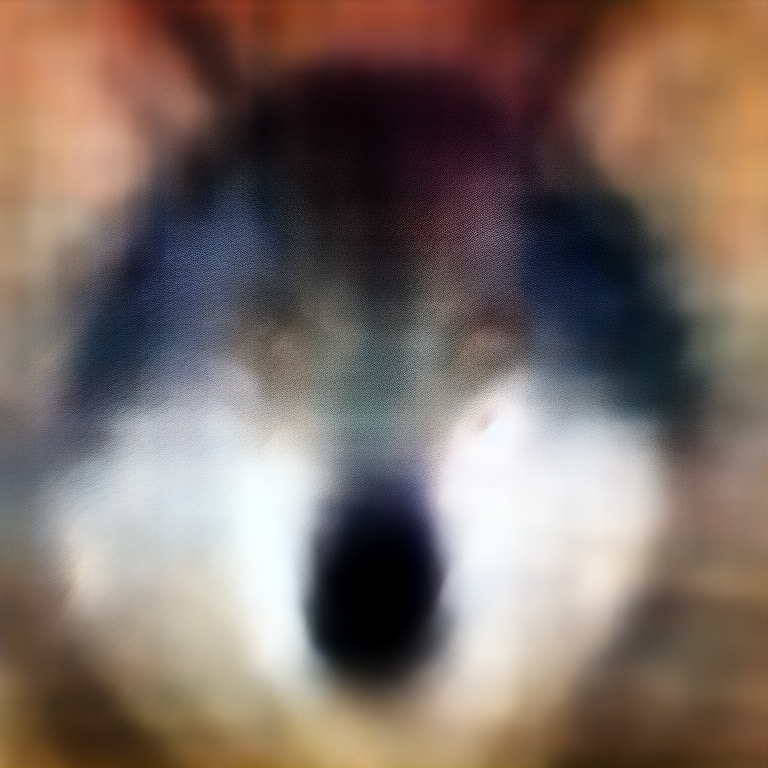

In [6]:
prompt2 = "a face of a wolf"
# latents, _ = pipe.create_latents(prompt)
latents_cache2 = LatentsCache()
pipe(prompt2, callback=latents_cache2, num_inference_steps=1).images[0]

In [65]:
from typing import List, Optional, Union


@torch.no_grad()
def run_inference_steps(
        pipe,
        prompt: Optional[Union[str, List[str]]],
        text_embeddings: Optional[torch.FloatTensor] = None,
        start_step: int = 0,
        num_inference_steps: int = 10,
        steps_to_run: Optional[int] = None,
        height: Optional[int] = None,
        width: Optional[int] = None,
        eta: float = 0.0,
        generator: Optional[torch.Generator] = None,
        num_images_per_prompt: int = 1,
        guidance_scale: float = 7.5,
        negative_prompt: Optional[Union[str, List[str]]] = None,
        latents: Optional[torch.FloatTensor] = None,
    ):
    height = height or pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = width or pipe.unet.config.sample_size * pipe.vae_scale_factor

    device = pipe._execution_device
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps
    do_classifier_free_guidance = guidance_scale > 1.0
    extra_step_kwargs = pipe.prepare_extra_step_kwargs(generator, eta)
    if prompt is not None:
        text_embeddings = pipe._encode_prompt(
            prompt, device, num_images_per_prompt, do_classifier_free_guidance, negative_prompt
        )

        batch_size = 1 if isinstance(prompt, str) else len(prompt)
    else:
        assert text_embeddings is not None, "Must provide either prompt or text_embeddings"
        batch_size = text_embeddings.shape[0]

    if latents is None:
        num_channels_latents = pipe.unet.in_channels
        latents = pipe.prepare_latents(
            batch_size * num_images_per_prompt,
            num_channels_latents,
            height,
            width,
            text_embeddings.dtype,
            device,
            generator,
            latents,
        )

    steps_to_run = steps_to_run or num_inference_steps
    for t in timesteps[start_step : start_step + steps_to_run]:
        # expand the latents if we are doing classifier free guidance
        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

        # predict the noise residual
        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

        # perform guidance
        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

            # compute the previous noisy sample x_t -> x_t-1
            latents = pipe.scheduler.step(noise_pred, t, latents, **extra_step_kwargs).prev_sample

    # 8. Post-processing
    return pipe.decode_latents(latents), text_embeddings, latents

In [66]:
import matplotlib.pyplot as plt

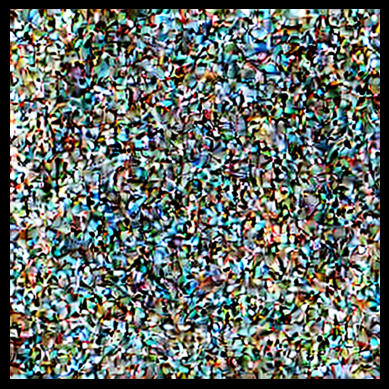

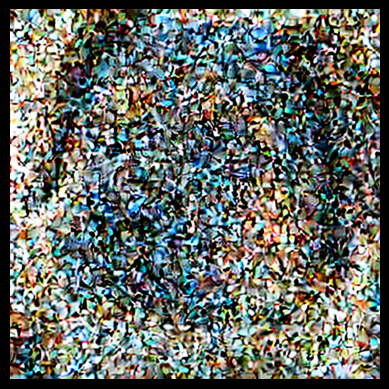

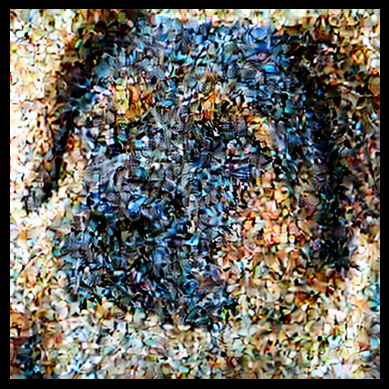

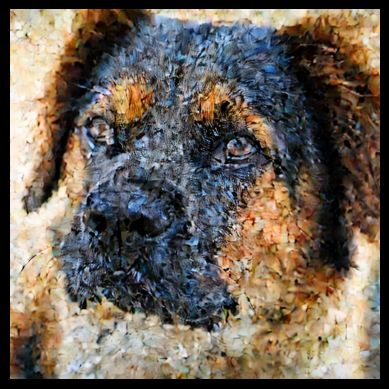

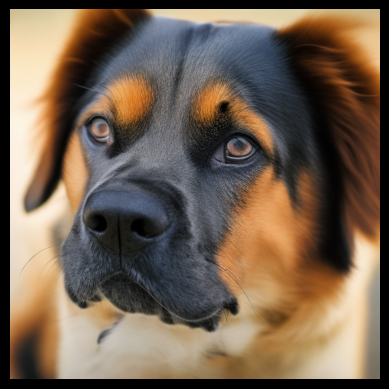

In [81]:
text_embeddings = None
latents = None
for i in range(5):
    img, text_embeddings, latents = run_inference_steps(pipe, "a face of a dog",
                                                        num_inference_steps=10,
                                                        text_embeddings=text_embeddings,
                                                        latents=latents,
                                                        start_step=2*i,
                                                        steps_to_run=2)
    plt.imshow(img[0])
    plt.axis('off')
    plt.show()

In [122]:
_, dog_text_embeddings, dog_latents = run_inference_steps(pipe, "the face of a dog",
                                                          num_inference_steps=10,
                                                          start_step=0,
                                                          steps_to_run=2)

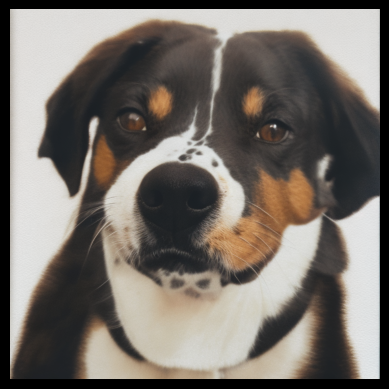

In [130]:
dog_img, *_ = run_inference_steps(pipe, None,
                                  num_inference_steps=10,
                                  text_embeddings=dog_text_embeddings.clone(),
                                  latents=dog_latents.clone(),
                                  start_step=2,
                                  steps_to_run=10)
plt.imshow(dog_img[0])
plt.axis('off')
plt.show()

In [95]:
_, wolf_text_embeddings, wolf_latents = run_inference_steps(pipe, "a face of a wolf",
                                                            num_inference_steps=10,
                                                            start_step=0,
                                                            steps_to_run=2)

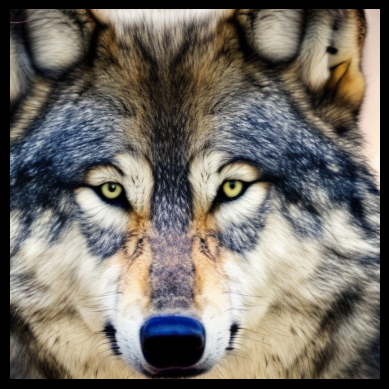

In [131]:
wolf_img, *_ = run_inference_steps(pipe, None,
                                   num_inference_steps=10,
                                   text_embeddings=wolf_text_embeddings.clone(),
                                   latents=wolf_latents.clone(),
                                   start_step=2,
                                   steps_to_run=10)
plt.imshow(wolf_img[0])
plt.axis('off')
plt.show()

In [146]:
def create_hiddens(pipe, prompt, initial_steps, inference_steps, generator=None):
    _, text_embeddings, latents = run_inference_steps(pipe, prompt,
                                                      num_inference_steps=inference_steps,
                                                      generator=generator,
                                                      start_step=0,
                                                      steps_to_run=initial_steps)
    final_img, *_ = run_inference_steps(pipe, None,
                                        num_inference_steps=inference_steps,
                                        text_embeddings=text_embeddings.clone(),
                                        latents=latents.clone(),
                                        start_step=initial_steps,
                                        steps_to_run=inference_steps)
    return final_img, text_embeddings, latents

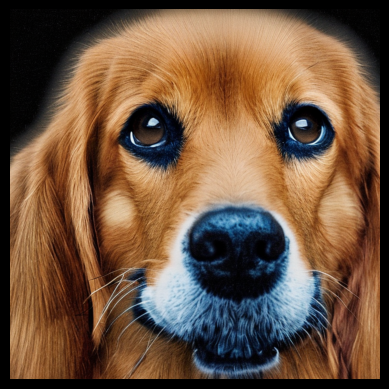

In [151]:
generator = torch.cuda.manual_seed(0)
final_img, text_embeddings, latents = create_hiddens(pipe, "a face of a dog", 2, 20, generator=generator)
plt.imshow(final_img[0])
plt.axis('off')
plt.show()

In [195]:
def interpolate(pipe,
                prompt1=None,
                prompt2=None,
                prompt1_hiddens=None,
                prompt2_hiddens=None,
                n_imgs = 10,
                img_inference_steps=10,
                interpolate_latents=False,
                initial_steps=2):

    if prompt1_hiddens is None:
        assert prompt1 is not None, "Must provide either prompt1 or prompt1_hiddens"
        _, prompt1_embeddings, prompt1_latents = run_inference_steps(pipe, prompt1,
                                                                     num_inference_steps=img_inference_steps,
                                                                     steps_to_run=initial_steps)
    else:
        assert prompt1_hiddens is not None, "Must provide either prompt1 or prompt1_hiddens"
        prompt1_embeddings, prompt1_latents = prompt1_hiddens

    if prompt2_hiddens is None:
        assert prompt2 is not None, "Must provide either prompt2 or prompt2_hiddens"
        _, prompt2_embeddings, prompt2_latents = run_inference_steps(pipe, prompt2,
                                                                     num_inference_steps=img_inference_steps,
                                                                     steps_to_run=initial_steps)
    else:
        assert prompt2_hiddens is not None, "Must provide either prompt2 or prompt2_hiddens"
        prompt2_embeddings, prompt2_latents = prompt2_hiddens

    l1 = prompt1_latents.clone()
    l2 = prompt2_latents.clone()
    e1 = prompt1_embeddings.clone()
    e2 = prompt2_embeddings.clone()
    diff_l = (l2 - l1) / n_imgs
    diff_e = (e2 - e1) / n_imgs
    imgs = []
    with pipe.progress_bar(total=n_imgs) as progress_bar:
        latents = l1
        for i in range(n_imgs):
            if interpolate_latents:
                latents = l1 + diff_l * i
            text_embeddings = e1 + diff_e * i
            img, *_ = run_inference_steps(pipe, None,
                                          num_inference_steps=img_inference_steps,
                                          text_embeddings=text_embeddings.clone(),
                                          latents=latents.clone(),
                                          start_step=initial_steps,
                                          steps_to_run=img_inference_steps)
            imgs.append(img)
            progress_bar.update()

    return imgs

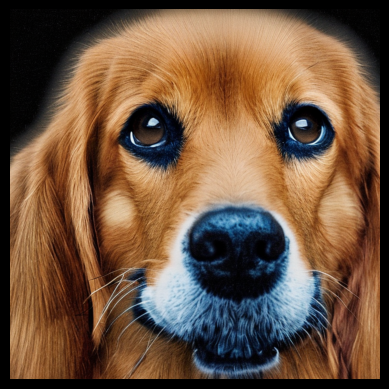

In [155]:
generator = torch.cuda.manual_seed(0)
final_img, dog_text_embeddings, dog_latents = create_hiddens(pipe, "a face of a dog", 2, 20, generator=generator)
show_img(final_img[0])

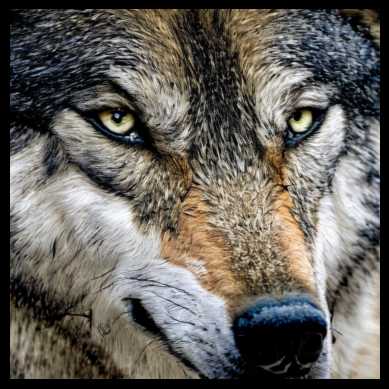

In [156]:
generator = torch.cuda.manual_seed(0)
final_img, wolf_text_embeddings, wolf_latents = create_hiddens(pipe, "a face of a wolf", 2, 20, generator=generator)
show_img(final_img[0])

In [157]:
imgs = interpolate(pipe,
                   prompt1_hiddens=(dog_text_embeddings, dog_latents),
                   prompt2_hiddens=(wolf_text_embeddings, wolf_latents),
                   img_inference_steps=20, initial_steps=2)

  0%|          | 0/10 [00:00<?, ?it/s]

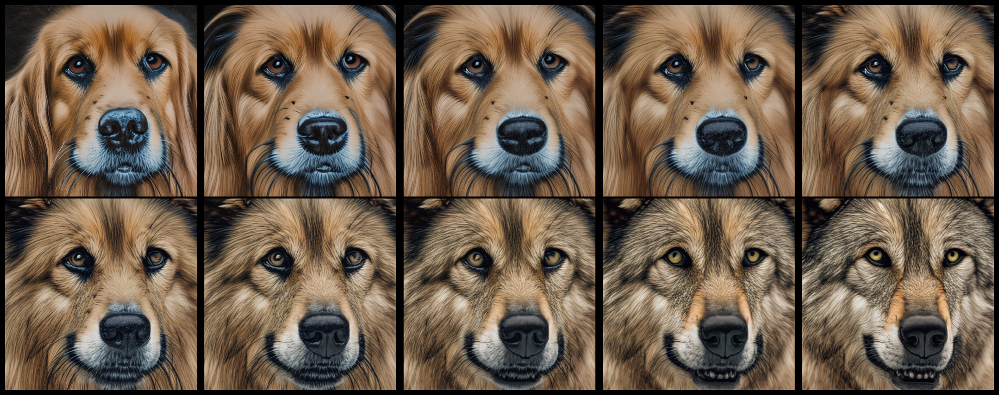

In [158]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
for i, img in enumerate(imgs):
    axs[i // 5][i % 5].imshow(img[0])
    axs[i // 5][i % 5].axis('off')
plt.tight_layout()
plt.show()

In [162]:
imgs = interpolate(pipe,
                   prompt1_hiddens=(dog_text_embeddings, dog_latents),
                   prompt2_hiddens=(wolf_text_embeddings, wolf_latents),
                   n_imgs=300,
                   img_inference_steps=20,
                   initial_steps=2)

  0%|          | 0/300 [00:00<?, ?it/s]

In [172]:
video = save_video([(255 * im[0]).astype(np.uint8) for im in imgs], filename='dog_to_wolf', fps=30)

In [173]:
embed_mp4(video)

In [140]:
imgs = interpolate(pipe, "a face of a dog", "a face of a wolf", steps=20, initial_steps=2)

  0%|          | 0/10 [00:00<?, ?it/s]

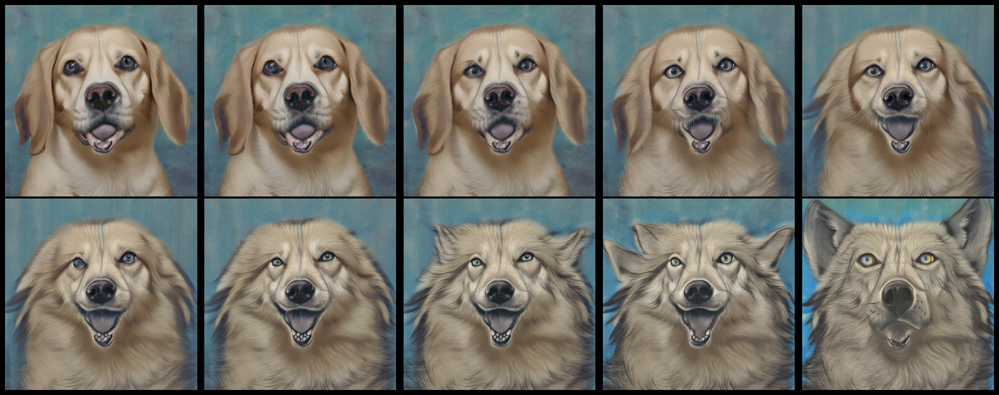

In [141]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
for i, img in enumerate(imgs):
    axs[i // 5][i % 5].imshow(img[0])
    axs[i // 5][i % 5].axis('off')
plt.tight_layout()
plt.show()

In [174]:
import gc
gc.collect()
torch.cuda.empty_cache()

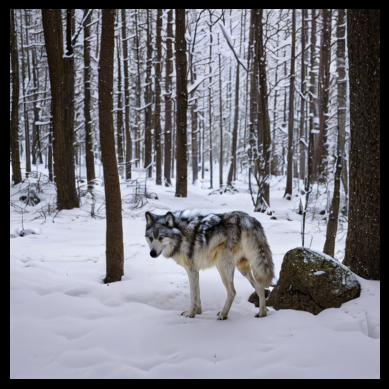

In [182]:
generator = torch.cuda.manual_seed(42)
final_img, wolf_text_embeddings, wolf_latents = create_hiddens(pipe,
                                                               "a wolf in a snowy forest",
                                                               2, 20, generator=generator)
show_img(final_img[0])

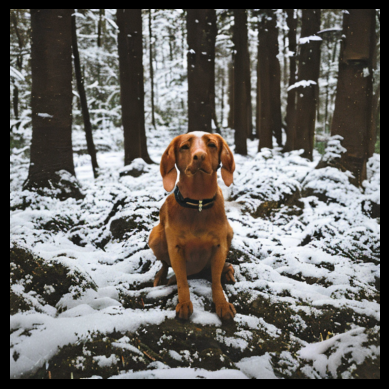

In [187]:
generator = torch.cuda.manual_seed(1)
final_img, dog_text_embeddings, dog_latents = create_hiddens(pipe,
                                                             "a dog in a snowy forest",
                                                             2, 20, generator=generator)
show_img(final_img[0])

  0%|          | 0/10 [00:00<?, ?it/s]

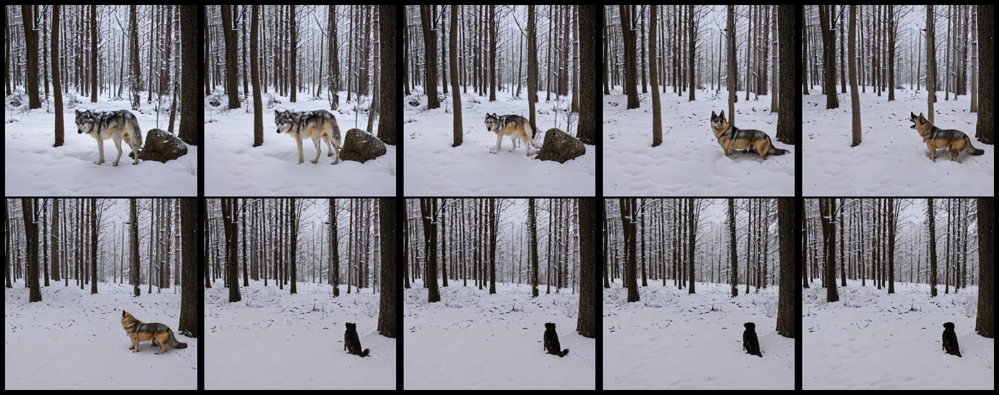

In [198]:
imgs = interpolate(pipe,
                   prompt1_hiddens=(wolf_text_embeddings, wolf_latents),
                   prompt2_hiddens=(dog_text_embeddings, dog_latents),
                   n_imgs=10,
                   img_inference_steps=20, initial_steps=2)
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
for i, img in enumerate(imgs):
    axs[i // 5][i % 5].imshow(img[0])
    axs[i // 5][i % 5].axis('off')
plt.tight_layout()
plt.show()

### Testing Interpolating Latents

In [196]:
imgs = interpolate(pipe,
                   prompt1_hiddens=(wolf_text_embeddings, wolf_latents),
                   prompt2_hiddens=(dog_text_embeddings, dog_latents),
                   n_imgs=10, interpolate_latents=True,
                   img_inference_steps=20, initial_steps=2)

  0%|          | 0/10 [00:00<?, ?it/s]

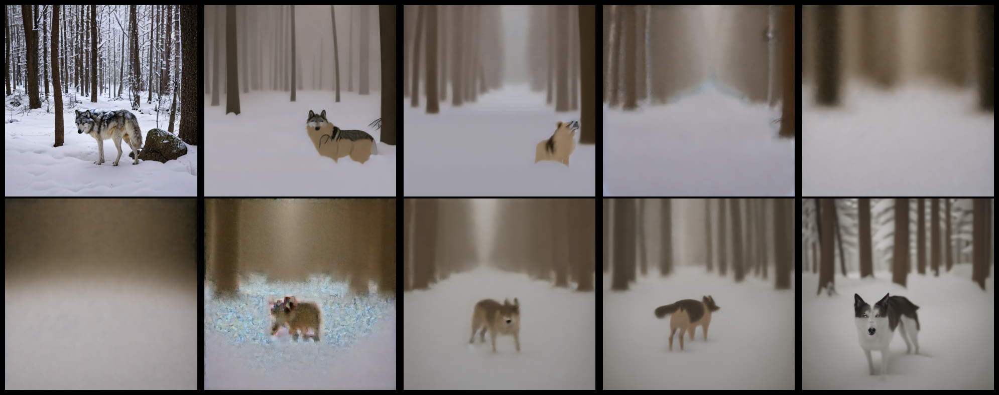

In [197]:
fig, axs = plt.subplots(2, 5, figsize=(20, 8))
for i, img in enumerate(imgs):
    axs[i // 5][i % 5].imshow(img[0])
    axs[i // 5][i % 5].axis('off')
plt.tight_layout()
plt.show()